## Sentinel SAR Floodwater Detection: Unet Model

In [16]:
!pip install tifffile
!pip install albumentations
!pip install imagecodecs

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [13]:
# Install ipywidgets and enable extensions
!pip install ipywidgets
!jupyter nbextension enable --py widgetsnbextension
!jupyter nbextension install --py widgetsnbextension

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 KB 1.8 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.4/214.4 KB 4.3 MB/s eta 0:00:00a 0:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 7.9 MB/s eta 0:00:0000:0100:01
Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK
Installing /home/aymanb/.local/lib/python3.10/site-packages/widgetsnbextension/static -> jupyter-js-widgets
Traceback (most recent call last):
  File "/usr/lib/python3.10/pathlib.py", line 1175, in mkdir
    self._accessor.mkdir(self, mode)
FileNotFoundError: [Errno 2] No such file or directory: '/usr/local/share/jupyter/nbextensions'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/aymanb/.local/bin/jupyter-nbextension", line 8, in <module>
    sys.exit(main())
  File "/home/aymanb/.local/lib/py

# Visualize the data

The dataset consists of 900 [Sentinel 1](https://sentinel.esa.int/web/sentinel/missions/sentinel-1) and coincident [Sentinel 2](https://sentinel.esa.int/web/sentinel/missions/sentinel-2) chips of size 512x512 px together with pixel-wise water labels. 

The scenes are very close in time, but can be up to 3 days apart. Hence, the water labels can also be slightly different.

In [17]:
import numpy as np
import glob
import os
import tifffile
import matplotlib.pyplot as plt

Sentinel-1 performs synthetic aperture radar (SAR) imaging, enabling it to see in all weather conditions and day and night. To better visualize the bands or channels of Sentinel-1 images we will create a false color composite by treating the two bands and their ratio as red, green and blue channels.

Sentinel-2 uses an multispectral optical sensor that captures reflected light in the visible and infrared spectrum. We are using the shortwave infrared, near infrared, and green composite which is great for spotting water. You can find out more about false color composites [here](https://earthobservatory.nasa.gov/features/FalseColor).

Helper functions for visualizations:

In [18]:
def visualize_s2_img(s2_channel_paths):
    """
    Calculates and returns a 'SWIR' S2 false color composite ready for visualization.

    Args:
        s2_channel_paths (list of str): Paths to the ['B12', 'B7', 'B4'] bands of a S2 image.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    img = []
    for path in s2_channel_paths:
        img.append(tifffile.imread(path))
    img = np.stack(img, axis=-1)
    return scale_S1_S2_img(img, sentinel=2)

def visualize_s1_img(path_vv, path_vh):
    """
    Calculates and returns a S1 false color composite ready for visualization.

    Args:
        path_vv (str): Path to the VV band.
        path_vh (str): Path to the VH band.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    s1_img = np.stack((tifffile.imread(path_vv), tifffile.imread(path_vh)), axis=-1)

    img = np.zeros((s1_img.shape[0], s1_img.shape[1], 3), dtype=np.float32)
    img[:, :, :2] = s1_img.copy()
    img[:, :, 2] = s1_img[:, :, 0] / s1_img[:, :, 1]
    s1_img = np.nan_to_num(s1_img)
    return scale_S1_S2_img(img, sentinel=1)

def scale_S1_S2_img(matrix, sentinel=2):
    """
    Returns a scaled (H,W,D) image which is more easily visually inspectable. Image is linearly scaled between
    min and max_value of by channel
    
    Args:
        matrix (np.array): (H,W,D) image to be scaled
        sentinel (int, optional): Sentinel 1 or Sentinel 2 image? Determines the min and max values for scalin, defaults to 2.

    Returns:
        np.array: Image (H, W, 3) ready for visualization with e.g. plt.imshow(..)
    """
    w, h, d = matrix.shape
    min_values = np.array([100, 100, 100]) if sentinel == 2 else np.array([-23, -28, 0.2])
    max_values = np.array([3500, 3500, 3500]) if sentinel == 2 else np.array([0, -5, 1])

    matrix = np.reshape(matrix, [w * h, d]).astype(np.float64)
    matrix = (matrix - min_values[None, :]) / (max_values[None, :] - min_values[None, :])
    matrix = np.reshape(matrix, [w, h, d])

    matrix = matrix.clip(0, 1)
    return matrix

__Let's plot some random Sentinel-1 chips, their water labels and corresponding Sentinel-2 images with their water labels.__

In [35]:
ayman_path = '/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips'
S1_label_paths = sorted(glob.glob("/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/*/s1/*/LabelWater.tif"))
S1_label_paths[:2]

['/scratch/users/jpduncan/c2s-ms/chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151511_20180507T151540_010817_013C63_3087_01845-00514/LabelWater.tif',
 '/scratch/users/jpduncan/c2s-ms/chips/0c7daa97-37f6-4862-867f-b3843f298d9e/s1/S1B_IW_GRDH_1SDV_20180507T151511_20180507T151540_010817_013C63_3087_01845-01022/LabelWater.tif']

# Training a Sentinel 1 baseline model with PyTorch

Now, let's train a water segmentation model using only Sentinel-1 data as input.

In [20]:
import torch

print(torch.__version__)

2.3.0+cu121


In [19]:
import torch
import torch.nn as nn
import albumentations
import os
import time
import segmentation_models_pytorch as smp

## Split the data into train, validation and test set

We start out with a simple random 70%/15%/15% train, validation and test split.

In [21]:
train_percentage = 0.7
val_percentage = 0.15
test_percentage = 0.15

S1_label_paths = sorted(glob.glob("/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/*/s1/*/LabelWater.tif"))
S1_img_paths = [[path.replace("LabelWater.tif", "VV.tif"), path.replace("LabelWater.tif", "VH.tif")] for path in S1_label_paths]

np.random.seed(1778)
np.random.shuffle(S1_label_paths)
np.random.seed(1778)
np.random.shuffle(S1_img_paths)

S1_img_paths_train = S1_img_paths[: int(train_percentage * len(S1_img_paths))]
S1_img_paths_val = S1_img_paths[int(train_percentage * len(S1_img_paths)): int((train_percentage + val_percentage) * len(S1_img_paths))]
S1_img_paths_test = S1_img_paths[int((train_percentage + val_percentage) * len(S1_img_paths)):]

S1_label_paths_train = S1_label_paths[: int(train_percentage * len(S1_label_paths))]
S1_label_paths_val = S1_label_paths[int(train_percentage * len(S1_label_paths)): int((train_percentage + val_percentage) * len(S1_label_paths))]
S1_label_paths_test = S1_label_paths[int((train_percentage + val_percentage) * len(S1_label_paths)):]

print(f"Train has {len(S1_img_paths_train)} images and {len(S1_label_paths_train)} labels")
print(f"Val   has {len(S1_img_paths_val)} images and {len(S1_label_paths_val)} labels")
print(f"Test  has {len(S1_img_paths_test)} images and {len(S1_label_paths_test)} labels")

Train has 630 images and 630 labels
Val   has 135 images and 135 labels
Test  has 135 images and 135 labels


## Create PyTorch datasets and look at some samples

The two channels of Sentinel-1 (VV and VH) are in float32 and have both negative and positive values. We normalize them to lie between 0 and 1 by applying [min-max normalization](https://en.wikipedia.org/wiki/Feature_scaling#Rescaling_.28min-max_normalization.29) with min = -77 and max = 26.

In [22]:
class Sentinel1_Dataset(torch.utils.data.Dataset):
    def __init__(
        self,
        img_paths,
        mask_paths,
        transforms=None, # POSSIBLY CHANGE FOR HIGHER SCORE
        min_normalize=-77,
        max_normalize=26,
    ):
        self.img_paths = img_paths
        self.mask_paths = mask_paths
        self.transforms = transforms
        self.min_normalize = min_normalize
        self.max_normalize = max_normalize

    def __getitem__(self, idx):
        # Load in image
        arr_x = []
        for path in self.img_paths[idx]:
            arr_x.append(tifffile.imread(path))
        arr_x = np.stack(arr_x, axis=-1)

        # Min-Max Normalization
        arr_x = np.clip(arr_x, self.min_normalize, self.max_normalize)
        arr_x = (arr_x - self.min_normalize) / (self.max_normalize - self.min_normalize)

        sample = {"image": arr_x}

        # Load in label mask
        sample["mask"] = tifffile.imread(self.mask_paths[idx])

        # Apply Data Augmentation
        if self.transforms:
            sample = self.transforms(image=sample["image"], mask=sample["mask"])
        if sample["image"].shape[-1] < 20:
            sample["image"] = sample["image"].transpose((2, 0, 1))

        return sample

    def __len__(self):
        return len(self.img_paths)

    def visualize(self, how_many=1, show_specific_index=None):
        for _ in range(how_many):
            rand_int = np.random.randint(len(self.img_paths))
            if show_specific_index is not None:
                rand_int = show_specific_index
            print(self.img_paths[rand_int][0])
            f, axarr = plt.subplots(1, 3, figsize=(30, 9))
            axarr[0].imshow(visualize_s1_img(self.img_paths[rand_int][0], self.img_paths[rand_int][1]))
            sample = self.__getitem__(rand_int)

            img = sample["image"]
            axarr[0].set_title(f"FCC of original S1 image", fontsize=15)
            axarr[1].imshow(img[0]) # Just visualize the VV band here
            axarr[1].set_title(f"VV band returned from the dataset, Min: {img.min():.4f}, Max: {img.max():.4f}", fontsize=15)
            if "mask" in sample.keys():
                axarr[2].set_title(f"Corresponding water mask: {(sample['mask'] == 1).sum()} px", fontsize=15)
                mask = mask_to_img(sample["mask"], {1: (0, 0, 255)})
                axarr[2].imshow(mask)
            plt.tight_layout()
            plt.show()
            
def mask_to_img(label, color_dict):
    """Recodes a (H,W) mask to a (H,W,3) RGB image according to color_dict"""
    mutually_exclusive = np.zeros(label.shape + (3,), dtype=np.uint8)
    for key in range(1, len(color_dict.keys()) + 1):
        mutually_exclusive[label == key] = color_dict[key]
    return mutually_exclusive

To prevent overfitting while training, we apply typical data augmentations like random cropping and random 90 degree rotations, horizontal and vertical flipping.

For validation, we don't apply any data augmentations and just predict on the full 512x512 chips.

In [23]:
train_crop_size = 256

train_transforms = albumentations.Compose(
    [
        albumentations.RandomCrop(train_crop_size, train_crop_size),
        albumentations.RandomRotate90(),
        albumentations.HorizontalFlip(),
        albumentations.VerticalFlip()
    ]
)

train_dataset = Sentinel1_Dataset(
    S1_img_paths_train,
    S1_label_paths_train,
    transforms=train_transforms,
    min_normalize=-77,
    max_normalize=26,
    )

val_dataset = Sentinel1_Dataset(
    S1_img_paths_val,
    S1_label_paths_val,
    transforms=None,
    min_normalize=-77,
    max_normalize=26,
    )

test_dataset = Sentinel1_Dataset(
    S1_img_paths_test,
    S1_label_paths_test,
    transforms=None,
    min_normalize=-77,
    max_normalize=26,
    )
print(len(train_dataset), len(val_dataset), len(test_dataset))

630 135 135


Let's visualize some examples from the datasets.

## Train a pretrained Linknet segmentation model

We can finally train! Let's prepare the last missing pieces:
- DataLoaders to create training and validation batches of data using multiprocessing
- Loss function
- Validation metric

In [24]:
num_workers = 6
pin_memory = True

batch_size = 32
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=pin_memory)

val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0, pin_memory=pin_memory)

test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0, pin_memory=pin_memory)

For our __loss function__ we choose a standard mixture of 50% cross entropy, 50% dice loss which improves learning in the unbalanced class setting we are in (much more non-water than water).

In [25]:
EPS = 1e-7

class XEDiceLoss(nn.Module):
    """
    Mixture of alpha * CrossEntropy and (1 - alpha) * DiceLoss.
    """
    def __init__(self, alpha=0.5):
        super().__init__()
        self.xe = nn.CrossEntropyLoss()
        self.alpha = alpha

    def forward(self, preds, targets):
        xe_loss = self.xe(preds, targets)
        
        no_ignore = targets.ne(255)
        targets = targets.masked_select(no_ignore)

        preds = torch.softmax(preds, dim=1)[:, 1]
        preds = preds.masked_select(no_ignore) # added
        targets = (targets == 1).float()
        dice_loss = 1 - (2.0 * torch.sum(preds * targets)) / (torch.sum(preds + targets) + EPS)

        return self.alpha * xe_loss + (1 - self.alpha) * dice_loss

    def get_name(self):
        return "XEDiceLoss"

As a starting __validation metric__, we use a global Intersection over Union on the water class. For that, we need to calculate True Positives, False Positives and False Negatives.

In [26]:
def tp_fp_fn(preds, targets):
    tp = torch.sum(preds * targets)
    fp = torch.sum(preds) - tp
    fn = torch.sum(targets) - tp
    return tp.item(), fp.item(), fn.item()

The `AverageMeter` utility class allows us to track various metrics over training.

In [27]:
class AverageMeter(object):
    """
    Computes and stores the average and current value
    Adapted from https://github.com/pytorch/examples/blob/master/imagenet/main.py
    """

    def __init__(self):
        self.reset()

    def reset(self):
        self.val, self.avg, self.sum, self.count = 0, 0, 0, 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

__Training our first model__

Our hyperparameters for this training run:
- `experiment_name = "Exp3"` --> Name for this experiment. Best model weights will be saved in "trained_models/`experiment_name`".
- `backbone = "resnet34"` --> We are using the [smp](https://github.com/qubvel/segmentation_models.pytorch) library to initialize a [U-Net](https://arxiv.org/abs/1505.04597) model. Here, we are using a [ResNet34](https://arxiv.org/abs/1512.03385) pretrained on ImageNet as the encoder of the U-Net.
- `patience = 4` --> Reducing the learning rate after training for a while improves the performance most of the time. Here, we are the strategy of dividing the current learning rate in half after the validation IoU has not increased for 4 epochs using the [ReduceLROnPlateau](https://pytorch.org/docs/stable/generated/torch.optim.lr_scheduler.ReduceLROnPlateau.html) learning rate scheduler in PyTorch.
- `n_epochs = 1000` --> How long to train? Similar to our strategy of reducing the learning rate, we are stopping the training run when the validation IoU has not increased since three times the patience. The maximum number of epochs to train `n_epochs` can therefore be set to a very high number, because the training will surely end before reaching this high number. But it can be set to a very low number to test things out.
- `lr = 1e-3` --> We are using the [Adam](https://pytorch.org/docs/stable/generated/torch.optim.Adam.html#torch.optim.Adam) optimizer which is a good choice, because it is quite robust to various choices of learning rates. The default learning rate is 1e-3 for most libraries.

In [28]:
experiment_name = "ExpLinknet - Logan"
on_gpu = torch.cuda.is_available()

backbone = "resnet34"
patience = 4
n_epochs = 1000
lr = 1e-3

In [32]:
import segmentation_models_pytorch as smp

early_patience = patience * 3
log_path = f"trained_models/{experiment_name}"
os.makedirs(log_path, exist_ok=True)

model = smp.Linknet(
    encoder_name="resnet50",      # You can choose other backbones as well
    encoder_weights="imagenet",   # Use pre-trained weights for the encoder
    in_channels=2,                # Number of input channels (e.g., 2 for two-channel input)
    classes=2                     # Number of output classes
)

loss_func = XEDiceLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode="max",
    factor=0.5,
    patience=patience,
    verbose=True,
)

if on_gpu:
    model = model.cuda()

Let's start the training!
- We are tracking the average time it takes for the dataloader to yield us the next batch of data in `data_time`. If this is too high, we should improve our preprocessing speed or our usage of multiprocessing.
- We are tracking the average time it takes to complete a training/validation step in `batch_time`.

In [35]:
import torch
from torch.utils.data import DataLoader
from torch.cuda.amp import GradScaler, autocast
from tqdm import tqdm
import os
import glob
import time

# Assuming train_dataset and val_dataset are predefined datasets
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=6, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False, num_workers=6, pin_memory=True)

# Set the log path and create the directory if it doesn't exist
experiment_name = "ExpLinknet - Logan"
log_path = f"trained_models/{experiment_name}"
os.makedirs(log_path, exist_ok=True)

# Enable cuDNN benchmarking and deterministic settings
torch.backends.cudnn.benchmark = False
torch.backends.cudnn.enabled = False

torch.cuda.empty_cache()

scaler = GradScaler()

# Initialize tracking variables
save_dict = {"model_name": experiment_name}
best_metric, best_metric_epoch, early_stopping_metric = 0, 0, 0
early_stop_counter, best_val_early_stopping_metric = 0, 0
early_stop_flag, start_time = False, time.time()

# Variables for tracking the best F1 score
best_f1, best_f1_epoch = 0, 0

for curr_epoch_num in range(1, n_epochs):
    # Training loop
    model.train()
    torch.set_grad_enabled(True)

    losses, batch_time, data_time = AverageMeter(), AverageMeter(), AverageMeter()
    end = time.time()
    for iter_num, data in enumerate(tqdm(train_loader, desc=f"Training Epoch {curr_epoch_num}/{n_epochs}")):
        data_time.update(time.time() - end)
        x_data = data["image"]
        targets = data["mask"].long()
        if on_gpu:
            x_data, targets = x_data.cuda(non_blocking=True), targets.cuda(non_blocking=True)

        optimizer.zero_grad()
        
        with autocast():
            preds = model(x_data)
            
        loss = loss_func(preds, targets)
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        
        losses.update(loss.detach().item(), x_data.size(0))
        batch_time.update(time.time() - end)
        end = time.time()

    print(f"Ep: [{curr_epoch_num}] TotalT: {(time.time() - start_time) / 60:.1f} min, BatchT: {batch_time.avg:.3f}s, DataT: {data_time.avg:.3f}s, Loss: {losses.avg:.4f}")

    # Validation loop
    model.eval()
    torch.set_grad_enabled(False)

    batch_time, data_time, losses = AverageMeter(), AverageMeter(), AverageMeter()
    tps, fps, fns = 0, 0, 0

    end = time.time()
    for iter_num, data in enumerate(tqdm(val_loader, desc=f"Validating Epoch {curr_epoch_num}/{n_epochs}")):
        data_time.update(time.time() - end)
        x_data = data["image"]
        targets = data["mask"].long()
        if on_gpu:
            x_data, targets = x_data.cuda(non_blocking=True), targets.cuda(non_blocking=True)

        with autocast():
            preds = model(x_data)
            loss = loss_func(preds, targets)
        losses.update(loss.detach().item(), x_data.size(0))

        preds = torch.softmax(preds, dim=1)[:, 1]
        preds = (preds > 0.5).float()

        tp, fp, fn = tp_fp_fn(preds, targets)
        assert tp >= 0 and fp >= 0 and fn >= 0, f"Negative tp/fp/fn: tp: {tp}, fp: {fp}, fn: {fn}"
        tps += tp
        fps += fp
        fns += fn

        batch_time.update(time.time() - end)
        end = time.time()

    precision = tps / (tps + fps + EPS)
    recall = tps / (tps + fns + EPS)
    f1 = 2 * ((precision * recall) / (precision + recall + EPS))
    iou_global = tps / (tps + fps + fns + EPS)

    # Update learning rate scheduler
    early_stopping_metric = iou_global
    if curr_epoch_num > 6:
        scheduler.step(early_stopping_metric)

    print(f"Ep: [{curr_epoch_num}] ValT: {(batch_time.avg * len(val_loader)) / 60:.1f} min, BatchT: {batch_time.avg:.3f}s, DataT: {data_time.avg:.3f}s, Loss: {losses.avg:.4f}, Global IoU: {iou_global:.4f}, F1 Score: {f1:.4f} (val)")

    # Save model based on IoU
    if early_stopping_metric > best_metric:
        best_metric, best_metric_epoch = early_stopping_metric, curr_epoch_num
        save_dict.update(
            {
                "best_metric": best_metric,
                "epoch_num": curr_epoch_num,
                "model_state_dict": model.state_dict(),
                "optim_state_dict": optimizer.state_dict(),
            }
        )
        save_path = f"{log_path}/best_iou_{curr_epoch_num}_{best_metric:.4f}.pt"
        torch.save(save_dict, save_path)

    if f1 > best_f1:
        best_f1, best_f1_epoch = f1, curr_epoch_num

        save_path = f"{log_path}/best_f1_{curr_epoch_num}_{best_f1:.4f}.pt"
        torch.save(save_dict, save_path)

    # Early Stopping: Increment stop counter if metric didn't improve
    if early_stopping_metric < best_val_early_stopping_metric:
        early_stop_counter += 1  
    else:
        # Reset ES counters
        best_val_early_stopping_metric, early_stop_counter = early_stopping_metric, 0

    # ES: Stop when stop counter reaches ES patience
    if early_stop_counter > early_patience:
        print("Early Stopping")
        break
torch.cuda.empty_cache()

print(f"Best validation IoU of {best_metric:.5f} in epoch {best_metric_epoch}.")
print(f"Best validation F1 Score of {best_f1:.5f} in epoch {best_f1_epoch}.")


Training Epoch 1/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.23it/s]


Ep: [1] TotalT: 0.2 min, BatchT: 0.236s, DataT: 0.016s, Loss: nan


Validating Epoch 1/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.69it/s]


Ep: [1] ValT: 0.0 min, BatchT: 0.269s, DataT: 0.076s, Loss: 0.1877, Global IoU: 0.7812, F1 Score: 0.8772 (val)


Training Epoch 2/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.05it/s]


Ep: [2] TotalT: 0.4 min, BatchT: 0.246s, DataT: 0.023s, Loss: nan


Validating Epoch 2/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.66it/s]


Ep: [2] ValT: 0.0 min, BatchT: 0.270s, DataT: 0.082s, Loss: 0.1727, Global IoU: 0.7947, F1 Score: 0.8856 (val)


Training Epoch 3/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.56it/s]


Ep: [3] TotalT: 0.6 min, BatchT: 0.218s, DataT: 0.018s, Loss: nan


Validating Epoch 3/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.94it/s]


Ep: [3] ValT: 0.0 min, BatchT: 0.251s, DataT: 0.068s, Loss: 0.1784, Global IoU: 0.7916, F1 Score: 0.8837 (val)


Training Epoch 4/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.50it/s]


Ep: [4] TotalT: 0.8 min, BatchT: 0.222s, DataT: 0.017s, Loss: nan


Validating Epoch 4/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.87it/s]


Ep: [4] ValT: 0.0 min, BatchT: 0.256s, DataT: 0.069s, Loss: 0.1814, Global IoU: 0.7896, F1 Score: 0.8824 (val)


Training Epoch 5/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.48it/s]


Ep: [5] TotalT: 1.0 min, BatchT: 0.222s, DataT: 0.017s, Loss: nan


Validating Epoch 5/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.96it/s]


Ep: [5] ValT: 0.0 min, BatchT: 0.250s, DataT: 0.069s, Loss: 0.1635, Global IoU: 0.8047, F1 Score: 0.8918 (val)


Training Epoch 6/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.30it/s]


Ep: [6] TotalT: 1.2 min, BatchT: 0.231s, DataT: 0.027s, Loss: nan


Validating Epoch 6/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.83it/s]


Ep: [6] ValT: 0.0 min, BatchT: 0.258s, DataT: 0.076s, Loss: 0.1742, Global IoU: 0.7969, F1 Score: 0.8869 (val)


Training Epoch 7/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.41it/s]


Ep: [7] TotalT: 1.4 min, BatchT: 0.226s, DataT: 0.016s, Loss: nan


Validating Epoch 7/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.79it/s]


Ep: [7] ValT: 0.0 min, BatchT: 0.261s, DataT: 0.078s, Loss: 0.1688, Global IoU: 0.8046, F1 Score: 0.8917 (val)


Training Epoch 8/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.41it/s]


Ep: [8] TotalT: 1.5 min, BatchT: 0.226s, DataT: 0.017s, Loss: nan


Validating Epoch 8/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.86it/s]


Ep: [8] ValT: 0.0 min, BatchT: 0.256s, DataT: 0.074s, Loss: 0.1884, Global IoU: 0.7862, F1 Score: 0.8803 (val)


Training Epoch 9/1000: 100%|██████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.29it/s]


Ep: [9] TotalT: 1.7 min, BatchT: 0.232s, DataT: 0.019s, Loss: nan


Validating Epoch 9/1000: 100%|██████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.71it/s]


Ep: [9] ValT: 0.0 min, BatchT: 0.267s, DataT: 0.080s, Loss: 0.1821, Global IoU: 0.7971, F1 Score: 0.8871 (val)


Training Epoch 10/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.39it/s]


Ep: [10] TotalT: 1.9 min, BatchT: 0.227s, DataT: 0.019s, Loss: nan


Validating Epoch 10/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.65it/s]


Ep: [10] ValT: 0.0 min, BatchT: 0.271s, DataT: 0.085s, Loss: 0.1990, Global IoU: 0.7778, F1 Score: 0.8750 (val)


Training Epoch 11/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.41it/s]


Ep: [11] TotalT: 2.1 min, BatchT: 0.226s, DataT: 0.019s, Loss: nan


Validating Epoch 11/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.87it/s]


Ep: [11] ValT: 0.0 min, BatchT: 0.255s, DataT: 0.072s, Loss: 0.1672, Global IoU: 0.8051, F1 Score: 0.8920 (val)


Training Epoch 12/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.40it/s]


Ep: [12] TotalT: 2.3 min, BatchT: 0.226s, DataT: 0.017s, Loss: nan


Validating Epoch 12/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.83it/s]


Ep: [12] ValT: 0.0 min, BatchT: 0.258s, DataT: 0.074s, Loss: 0.1741, Global IoU: 0.8029, F1 Score: 0.8907 (val)


Training Epoch 13/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.49it/s]


Ep: [13] TotalT: 2.5 min, BatchT: 0.222s, DataT: 0.016s, Loss: nan


Validating Epoch 13/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.80it/s]


Ep: [13] ValT: 0.0 min, BatchT: 0.260s, DataT: 0.073s, Loss: 0.1713, Global IoU: 0.8046, F1 Score: 0.8917 (val)


Training Epoch 14/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.46it/s]


Ep: [14] TotalT: 2.7 min, BatchT: 0.224s, DataT: 0.018s, Loss: nan


Validating Epoch 14/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.78it/s]


Ep: [14] ValT: 0.0 min, BatchT: 0.262s, DataT: 0.075s, Loss: 0.1994, Global IoU: 0.7757, F1 Score: 0.8737 (val)


Training Epoch 15/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.43it/s]


Ep: [15] TotalT: 2.9 min, BatchT: 0.225s, DataT: 0.016s, Loss: nan


Validating Epoch 15/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.81it/s]


Ep: [15] ValT: 0.0 min, BatchT: 0.260s, DataT: 0.075s, Loss: 0.1716, Global IoU: 0.8058, F1 Score: 0.8925 (val)


Training Epoch 16/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.39it/s]


Ep: [16] TotalT: 3.1 min, BatchT: 0.227s, DataT: 0.017s, Loss: nan


Validating Epoch 16/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.63it/s]


Ep: [16] ValT: 0.0 min, BatchT: 0.273s, DataT: 0.084s, Loss: 0.1746, Global IoU: 0.8024, F1 Score: 0.8904 (val)


Training Epoch 17/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.41it/s]


Ep: [17] TotalT: 3.3 min, BatchT: 0.226s, DataT: 0.016s, Loss: nan


Validating Epoch 17/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.80it/s]


Ep: [17] ValT: 0.0 min, BatchT: 0.260s, DataT: 0.073s, Loss: 0.1673, Global IoU: 0.8056, F1 Score: 0.8924 (val)


Training Epoch 18/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.45it/s]


Ep: [18] TotalT: 3.5 min, BatchT: 0.224s, DataT: 0.015s, Loss: nan


Validating Epoch 18/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.67it/s]


Ep: [18] ValT: 0.0 min, BatchT: 0.269s, DataT: 0.082s, Loss: 0.1746, Global IoU: 0.7992, F1 Score: 0.8884 (val)


Training Epoch 19/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.36it/s]


Ep: [19] TotalT: 3.7 min, BatchT: 0.228s, DataT: 0.018s, Loss: nan


Validating Epoch 19/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.78it/s]


Ep: [19] ValT: 0.0 min, BatchT: 0.262s, DataT: 0.076s, Loss: 0.1652, Global IoU: 0.8032, F1 Score: 0.8909 (val)


Training Epoch 20/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.46it/s]


Ep: [20] TotalT: 3.9 min, BatchT: 0.223s, DataT: 0.018s, Loss: nan


Validating Epoch 20/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.83it/s]


Ep: [20] ValT: 0.0 min, BatchT: 0.258s, DataT: 0.074s, Loss: 0.1877, Global IoU: 0.7832, F1 Score: 0.8784 (val)


Training Epoch 21/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.38it/s]


Ep: [21] TotalT: 4.1 min, BatchT: 0.227s, DataT: 0.019s, Loss: nan


Validating Epoch 21/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.85it/s]


Ep: [21] ValT: 0.0 min, BatchT: 0.257s, DataT: 0.071s, Loss: 0.1889, Global IoU: 0.7894, F1 Score: 0.8823 (val)


Training Epoch 22/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.49it/s]


Ep: [22] TotalT: 4.2 min, BatchT: 0.222s, DataT: 0.017s, Loss: nan


Validating Epoch 22/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.82it/s]


Ep: [22] ValT: 0.0 min, BatchT: 0.259s, DataT: 0.073s, Loss: 0.1790, Global IoU: 0.7943, F1 Score: 0.8854 (val)


Training Epoch 23/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.43it/s]


Ep: [23] TotalT: 4.4 min, BatchT: 0.225s, DataT: 0.018s, Loss: nan


Validating Epoch 23/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.80it/s]


Ep: [23] ValT: 0.0 min, BatchT: 0.260s, DataT: 0.075s, Loss: 0.1775, Global IoU: 0.7955, F1 Score: 0.8861 (val)


Training Epoch 24/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.37it/s]


Ep: [24] TotalT: 4.6 min, BatchT: 0.228s, DataT: 0.016s, Loss: nan


Validating Epoch 24/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.67it/s]


Ep: [24] ValT: 0.0 min, BatchT: 0.269s, DataT: 0.075s, Loss: 0.1683, Global IoU: 0.8029, F1 Score: 0.8907 (val)


Training Epoch 25/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:09<00:00,  4.29it/s]


Ep: [25] TotalT: 4.8 min, BatchT: 0.233s, DataT: 0.017s, Loss: nan


Validating Epoch 25/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.84it/s]


Ep: [25] ValT: 0.0 min, BatchT: 0.257s, DataT: 0.074s, Loss: 0.1755, Global IoU: 0.7972, F1 Score: 0.8872 (val)


Training Epoch 26/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:08<00:00,  4.46it/s]


Ep: [26] TotalT: 5.0 min, BatchT: 0.224s, DataT: 0.017s, Loss: nan


Validating Epoch 26/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.80it/s]


Ep: [26] ValT: 0.0 min, BatchT: 0.260s, DataT: 0.073s, Loss: 0.1742, Global IoU: 0.7994, F1 Score: 0.8885 (val)


Training Epoch 27/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:10<00:00,  3.96it/s]


Ep: [27] TotalT: 5.2 min, BatchT: 0.252s, DataT: 0.019s, Loss: nan


Validating Epoch 27/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.45it/s]


Ep: [27] ValT: 0.0 min, BatchT: 0.286s, DataT: 0.086s, Loss: 0.1754, Global IoU: 0.7970, F1 Score: 0.8870 (val)


Training Epoch 28/1000: 100%|█████████████████████████████████████████████████| 40/40 [00:10<00:00,  3.93it/s]


Ep: [28] TotalT: 5.4 min, BatchT: 0.253s, DataT: 0.019s, Loss: nan


Validating Epoch 28/1000: 100%|█████████████████████████████████████████████████| 9/9 [00:02<00:00,  3.50it/s]

Ep: [28] ValT: 0.0 min, BatchT: 0.283s, DataT: 0.090s, Loss: 0.1745, Global IoU: 0.7986, F1 Score: 0.8880 (val)
Early Stopping
Best validation IoU of 0.80579 in epoch 15.
Best validation F1 Score of 0.89245 in epoch 15.


# Calculate test set IoU and visualize predictions on the test set

Our best validation global IoU is __XXX__ and F1 Score is __XXX__. How does our model perform on the testset?

In [36]:
experiment_name = "ExpLinknet - Logan"
backbone = "resnet34"
on_gpu = torch.cuda.is_available()

model_weights_path = glob.glob(f"trained_models/{experiment_name}/best_iou*")[0]

model = smp.Linknet(
    encoder_name="resnet50",      # You can choose other backbones as well
    encoder_weights="imagenet",   # Use pre-trained weights for the encoder
    in_channels=2,                # Number of input channels (e.g., 2 for two-channel input)
    classes=2                     # Number of output classes
)
if on_gpu:
    model = model.cuda()
model.eval()

cp = torch.load(model_weights_path)
model.load_state_dict(cp["model_state_dict"])
print(f"Loaded {model_weights_path} at epoch {cp['epoch_num']}")

Loaded trained_models/ExpLinknet - Logan/best_iou_11_0.8051.pt at epoch 11


In [38]:
tps, fps, fns = 0, 0, 0
probs = []
torch.set_grad_enabled(False)

for data in test_loader:
    x_data = data["image"]
    targets = data["mask"].long()
    if on_gpu:
        x_data, targets = x_data.cuda(non_blocking=True), targets.cuda(non_blocking=True)

    preds = torch.softmax(model(x_data), dim=1)[:, 1]
    preds = (preds > 0.5).float()

    tp, fp, fn = tp_fp_fn(preds, targets)
    assert tp >= 0 and fp >= 0 and fn >= 0, f"Negative tp/fp/fn: tp: {tp}, fp: {fp}, fn: {fn}"
    tps += tp
    fps += fp
    fns += fn

    probs.append(preds.cpu().numpy())

iou_global = tps / (tps + fps + fns + EPS)

precision = tps / (tps + fps + EPS)
recall = tps / (tps + fns + EPS)
f1 = 2 * ((precision * recall) / (precision + recall + EPS))

last_prob = probs[-1].copy()
probs = np.array(probs[:-1]).reshape((-1, 512, 512))

probs = np.concatenate((probs, last_prob), 0)
print(probs.shape)  # (135, 512, 512)
print(f"Test set global IoU: {iou_global:.4f}")
print(f"Test set F1 Score: {f1:.4f}")

# Save F1 score to a file
f1_score_path = f"trained_models/{experiment_name}/test_f1_score.txt"
with open(f1_score_path, "w") as f:
    f.write(f"Test set F1 Score: {f1:.4f}\n")
    f.write(f"Test set global IoU: {iou_global:.4f}\n")


(135, 512, 512)
Test set global IoU: 0.7058
Test set F1 Score: 0.8275


Our model performs a bit worse on the test set, which is suprising for a random split. This tells me the data can be volatile and splits must be created with great care.

Finally, let's look at some random predictions on the test set.

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/8fcb3e59-7b1b-49c9-92c4-f4ddea14d4e4/s1/S1A_IW_GRDH_1SDV_20200806T043438_20200806T043503_033781_03EA77_63A9_06656-02048/LabelWater.tif


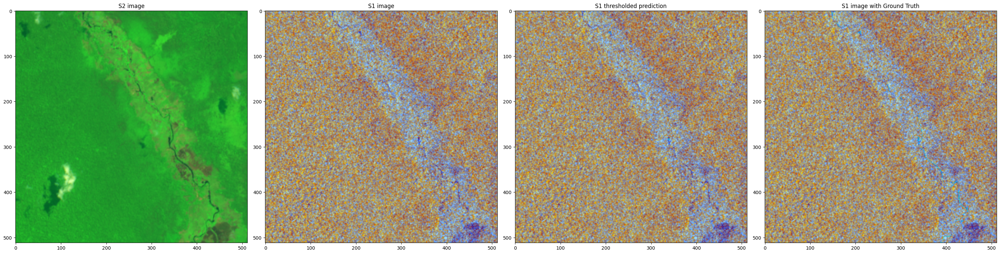

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/8fcb3e59-7b1b-49c9-92c4-f4ddea14d4e4/s1/S1A_IW_GRDH_1SDV_20200806T043438_20200806T043503_033781_03EA77_63A9_10240-07168/LabelWater.tif


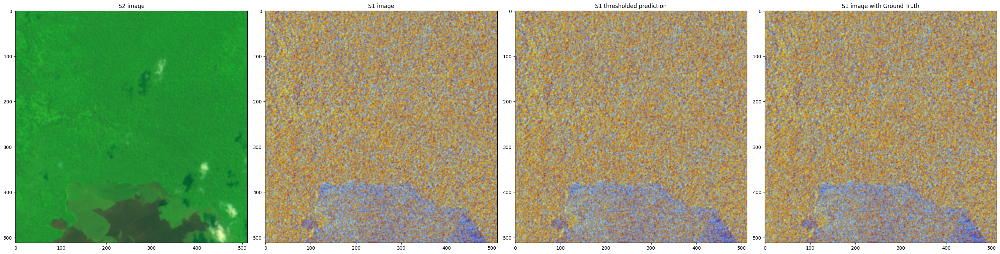

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/e7d1917e-c069-45cf-a392-42e24aa2f4ac/s1/S1B_IW_GRDH_1SDV_20201020T164222_20201020T164247_023899_02D6C4_35D8_01536-00000/LabelWater.tif


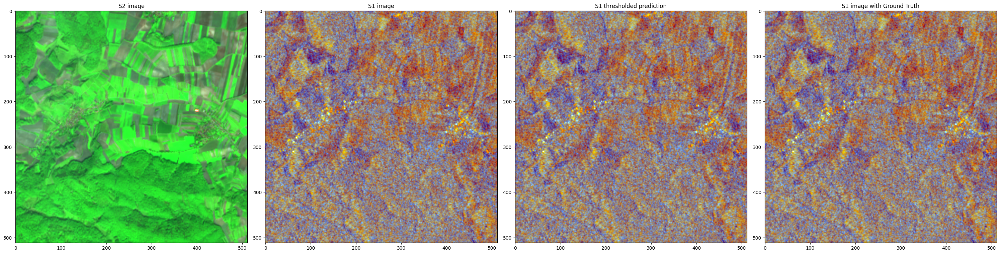

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/dc70be79-da19-47ee-bdee-4614bc46d610/s1/S1A_IW_GRDH_1SDV_20180507T160449_20180507T160514_021800_025A09_6700_05120-03072/LabelWater.tif


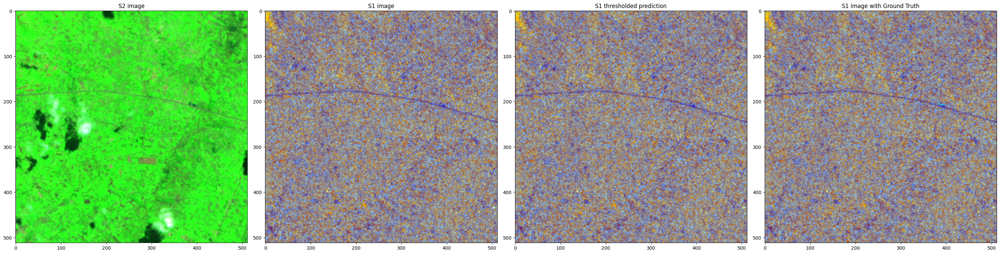

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/e7d1917e-c069-45cf-a392-42e24aa2f4ac/s1/S1B_IW_GRDH_1SDV_20201020T164222_20201020T164247_023899_02D6C4_35D8_04608-04096/LabelWater.tif


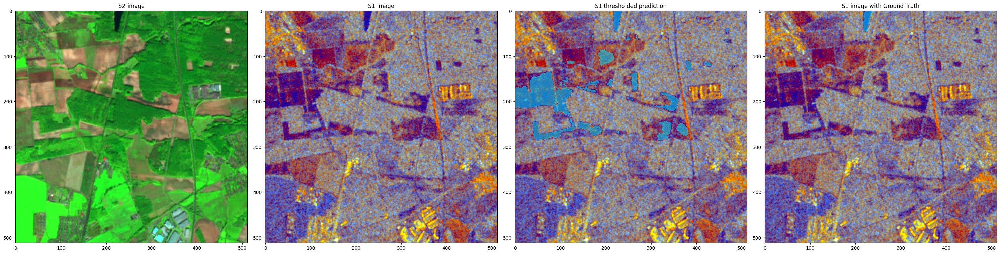

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/f59da1a3-a2f1-45b8-b975-57af1b344252/s1/S1A_IW_GRDH_1SDV_20190522T002101_20190522T002126_027333_031530_0129_10275-00897/LabelWater.tif


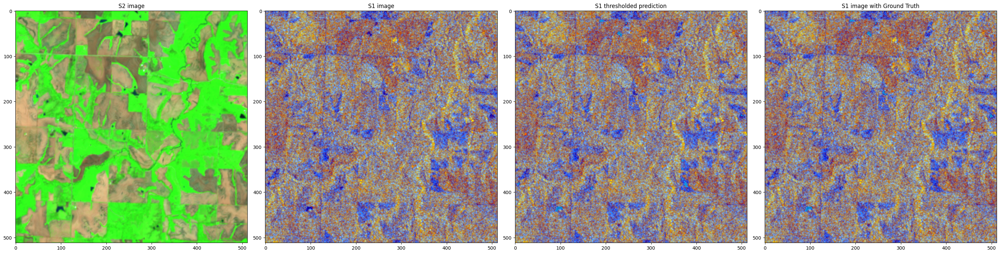

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/dc70be79-da19-47ee-bdee-4614bc46d610/s1/S1A_IW_GRDH_1SDV_20180507T160449_20180507T160514_021800_025A09_6700_05120-03072/LabelWater.tif


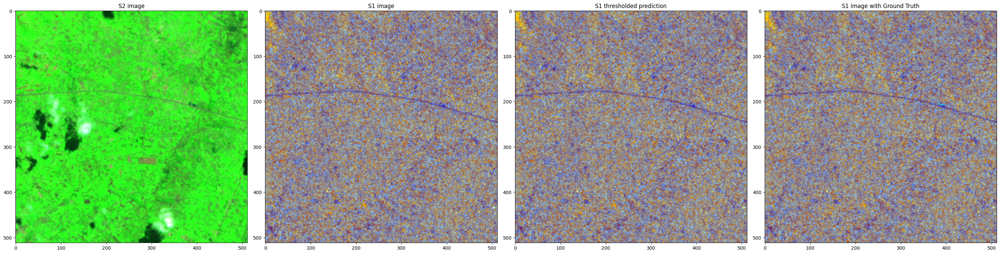

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/f59da1a3-a2f1-45b8-b975-57af1b344252/s1/S1A_IW_GRDH_1SDV_20190522T002101_20190522T002126_027333_031530_0129_00439-00094/LabelWater.tif


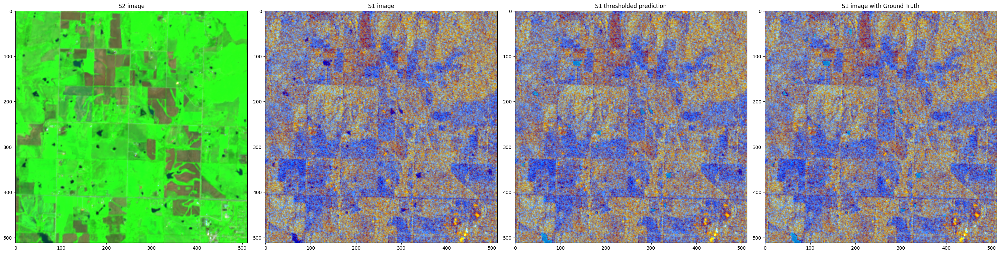

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/749aca10-a39b-4321-8322-100dd6f976d4/s1/S1B_IW_GRDH_1SDV_20190215T090752_20190215T090826_014954_01BECA_6119_02048-01536/LabelWater.tif


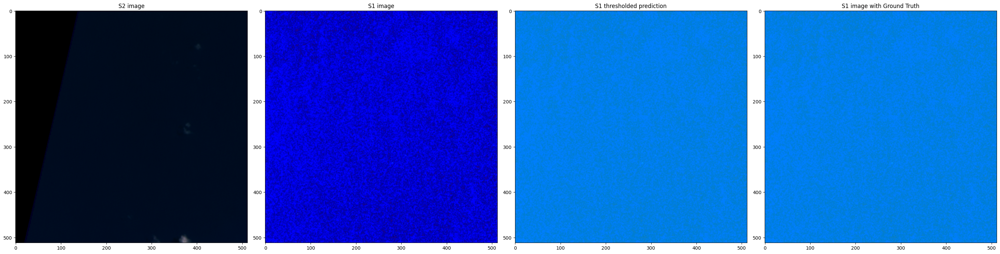

/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/d89b6d2c-ded5-463e-81cc-13c1764df616/s1/S1A_IW_GRDH_1SDV_20160812T234651_20160812T234716_012574_013B43_8C18_00456-04622/LabelWater.tif


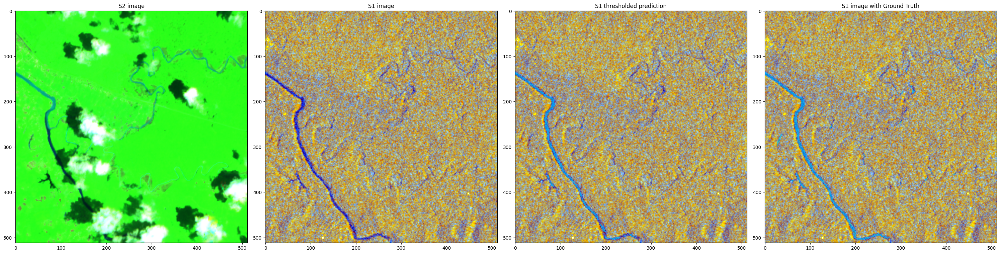

In [40]:
# plot random predictions vs ground truth
b_channels = ['B12', 'B7', 'B4']

show_how_many = 10
alpha = 0.5
for k in range(show_how_many):
    rand_int = np.random.randint(len(test_dataset))
    S1_label_path = test_dataset.mask_paths[rand_int]
    S1_VV_path = test_dataset.img_paths[rand_int][0]
    S1_VH_path = test_dataset.img_paths[rand_int][1]
    
    flood_event = S1_label_path.split("/")[6] # new location of flood_event in path
    position = S1_label_path.split("/")[-2].split("_")[-1]
    
    S2_label_path = glob.glob(f"/home/aymanb/AiROTC/ms-dataset-chips/ms-dataset-chips/{flood_event}/s2/*{position}/LabelWater.tif")[0]
    S2_bands_paths = [S2_label_path.replace("LabelWater.tif", f"{channel}.tif") for channel in b_channels]
    
    f, axarr = plt.subplots(1, 4, figsize=(30, 10))
    print(S1_label_path)
    s1_img = visualize_s1_img(S1_VV_path, S1_VH_path)
    axarr[1].imshow(s1_img)
    axarr[1].set_title("S1 image")
    s2_img = visualize_s2_img(S2_bands_paths)
    axarr[2].imshow(s1_img)
    axarr[2].set_title("S1 thresholded prediction")
    axarr[3].imshow(s1_img)
    axarr[3].set_title("S1 image with Ground Truth")
    
    axarr[0].imshow(s2_img)
    axarr[0].set_title("S2 image")
         
    pred = probs[rand_int]
    pred = np.ma.masked_where(pred == 0, pred)
    axarr[2].imshow(pred, cmap="cool", alpha=alpha)
    
    label = tifffile.imread(S1_label_path)
    label = np.ma.masked_where(label == 0, label)
    axarr[3].imshow(label, cmap="cool", alpha=alpha)
    
    plt.tight_layout()
    plt.show()